## *Swarm Simulator*

This is a notebook to generate the results in the paper:
Eliot, Kendall, Brockway, Oman, Bouridane,
_A novel potential field model for perimeter and agent density control in multiagent swarms_,
Expert Systems with Applications,
April 2023 (Accepted for publication)

## Checking the Installation

The `versioninfo()` function should print your Julia version and some other info about the system:

In [1]:
versioninfo()

Julia Version 1.8.5
Commit 17cfb8e65ea (2023-01-08 06:45 UTC)
Platform Info:
  OS: Linux (x86_64-linux-gnu)
  CPU: 8 × Intel(R) Core(TM) i7-8565U CPU @ 1.80GHz
  WORD_SIZE: 64
  LIBM: libopenlibm
  LLVM: libLLVM-13.0.1 (ORCJIT, skylake)
  Threads: 8 on 8 virtual cores
Environment:
  LD_LIBRARY_PATH = :/opt/gurobi901/linux64/lib:/opt/gurobi901/linux64/lib
  JULIA_NUM_THREADS = auto


## Initialisation

In [2]:
src = "."
config = "../data"
figs = "../results"

include("$(src)/model.jl")
import .SwarmModel as SM
using .SwarmModel

include("$(src)/modelstats.jl")
import .ModelStats as MS
using .ModelStats

## Plotting

In [3]:
import PyPlot; const plt = PyPlot
rcParams = PyPlot.PyDict(PyPlot.matplotlib."rcParams")
rcParams["font.family"] = "serif"
rcParams["font.size"] = 8
rcParams["figure.dpi"] = 200
rcParams["lines.linewidth"] = 1
rcParams["axes.labelsize"] = 6
rcParams["axes.titlesize"] = 7
rcParams["legend.fontsize"] = 5
rcParams["xtick.labelsize"] = 6
rcParams["ytick.labelsize"] = 6
rcParams["text.usetex"] = false
rcParams["figure.figsize"] = (3.5, 3.5)

function show_swarm(config_file; system=nothing, overrides=nothing, goal=nothing, title="", 
                    xlims=nothing, ylims=nothing, step=nothing, xmargin=1, ymargin=1, 
                    xtick_rotation=0, compute=true, with_params=true, markersize=1, savedfigure=nothing)
    if system !== nothing
        b, parameters = system
    else
        b, parameters = load_swarm(config_file)
        parameters = overrides === nothing ? parameters : merge(parameters, overrides)
    end
    if goal !== nothing
        b[:,SM.GOAL_X:SM.GOAL_Y] .= goal
    end
    if compute
        compute_step(b; parameters...)
    end
    prm = findall(b[:,SM.PRM] .> 0.)
    _prm = setdiff(1:size(b)[1], prm)
    if with_params
        paramstring = SM.stringify_parameters(parameters)
    else
        paramstring = ""
    end
    sep = config_file == "" ? "" : " - "
    title = title * sep * splitext(basename(config_file))[1] * "\n" * paramstring
    if xlims == nothing
        xlims = minimum(b[:,SM.POS_X]) - xmargin, maximum(b[:,SM.POS_X]) + xmargin
    end
    if ylims == nothing
        ylims = minimum(b[:,SM.POS_Y]) - ymargin, maximum(b[:,SM.POS_Y]) + ymargin
    end
    fig, ax  = plt.subplots()
    ax.set(xlim=xlims, ylim=ylims)        # set the limits of the axes
    if step !== nothing
        plt.xticks([n for n in xlims[1]:step:xlims[2]], rotation=xtick_rotation)
        plt.yticks([n for n in ylims[1]:step:ylims[2]])
    end
    ax.set_xlabel("POS_X")
    ax.set_ylabel("POS_Y")
    ax.set_aspect("equal")
    ax.set_title(title)
    plt.grid(alpha=0.25)
    plt.subplots_adjust(left=0.2, top=0.85)
    ax.plot(b[_prm,SM.POS_X],b[_prm,SM.POS_Y], "ko", markersize=markersize)
    ax.plot(b[prm,SM.POS_X],b[prm,SM.POS_Y], "ro", markersize=markersize)
    if goal !== nothing
        ax.plot([goal[1]], [goal[2]], "b+", markersize=4)
    end
    if savedfigure !== nothing
        fig.savefig(savedfigure, bbox_inches="tight")
    end
    return fig, ax
end

function plot_mean_distances(config_file="config/base_400.json"; system=nothing, goal=nothing,
                             means=nothing, stds=nothing, n_steps=500, plots=[:ii, :pi, :pp],
                             k=[2,1,1,2], pre_p=false, boundary=50, with_stdev=false, 
                             overrides=nothing, failure=nothing, alt_file=nothing, 
                             xlims=nothing, ylims=nothing, legend_loc="best", savedfigure=nothing)
    if system !== nothing
        b, parameters = system
    else
        b, parameters = load_swarm(config_file)
        parameters = overrides === nothing ? parameters : merge(parameters, overrides)
    end
    if goal !== nothing
        b[:,SM.GOAL_X:SM.GOAL_Y] .= goal
    end
    if pre_p
        p = MS.agent_perimeter_status(b, parameters, n_steps=n_steps, boundary=boundary)
    else
        p = nothing
    end
    if means === nothing
        means, stds = knn_mean_distances(b, parameters, n_steps=n_steps, class_ids=plots,
                                         k=k, perimeter=p, failure=failure)
    end
    ptype = with_stdev ? "\\Psi_d" : "\\mu_d"
    if alt_file !== nothing
        file_basename = alt_file
    else
        file_basename = splitext(basename(config_file))[1]
    end
    title = "Distance metric by perimeter class - $(file_basename)\n $(SM.stringify_parameters(parameters))"
    labels = Dict(:ii => "\$$(ptype)(S_i, S_i, $(k[1]))\$",
                  :ip => "\$$(ptype)(S_i, S_p, $(k[2]))\$",
                  :pi => "\$$(ptype)(S_p, S_i, $(k[3]))\$",
                  :pp => "\$$(ptype)(S_p, S_p, $(k[4]))\$")
    colors = Dict(:ii => "k-", :ip => "g-", :pi => "b-", :pp => "r-")
    facecolors = Dict(:ii => "black", :ip => "green", :pi => "blue", :pp => "red")
    fig, ax = plt.subplots(figsize=(3.5,2.5))
    ax.set_title(title)
    ax.set_xlabel("Simulation step number")
    ax.set_ylabel("\$$(ptype)\$")
    if xlims === nothing
        xlims = (0, n_steps)
    end
    if ylims === nothing
        ylims = (minimum(means) - maximum(stds), maximum(means) + maximum(stds))
    end
    ax.set(xlim=xlims, ylim=ylims)
    ax.grid(true)
    line = Array{Vector{plt.PyObject}, 1}(undef, length(plots))
    for i in 1:length(plots)
        p = plots[i]
        line[i] = ax.plot(means[:,i], colors[p], label=labels[p])
        if with_stdev
            ax.fill_between(1:n_steps, means[:,i] .+ stds[:,i], means[:,i] .- stds[:,i],
                            facecolor=facecolors[p], alpha=0.25)
        end
    end
    ax.legend(loc=legend_loc)
    plt.subplots_adjust(left=0.15, top=0.8, bottom=0.2)
    if savedfigure !== nothing
        fig.savefig(savedfigure, bbox_inches="tight")
    end
    return fig, ax, means, stds
end

plot_mean_distances (generic function with 2 methods)

## Swarms

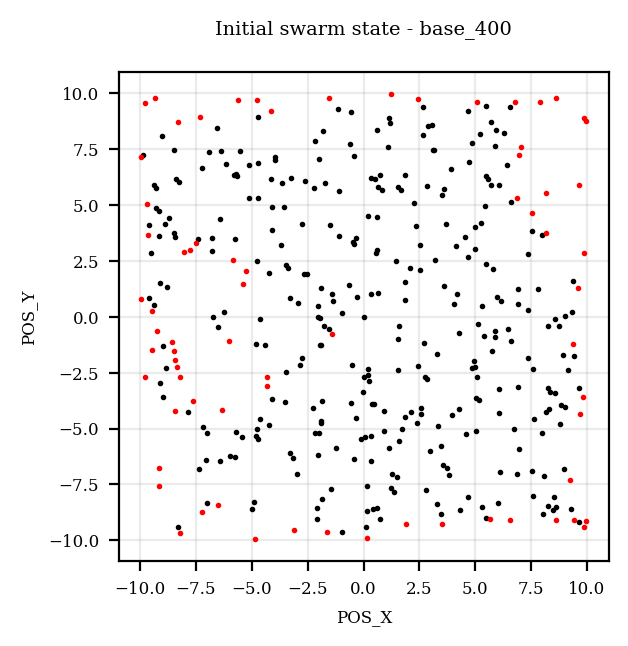

(PyPlot.Figure(PyObject <Figure size 700x700 with 1 Axes>), PyObject <Axes: title={'center': 'Initial swarm state - base_400\n'}, xlabel='POS_X', ylabel='POS_Y'>)

In [4]:
show_swarm("$(config)/base_400.json", title="Initial swarm state", savedfigure="$(figs)/base_400_init.pdf")

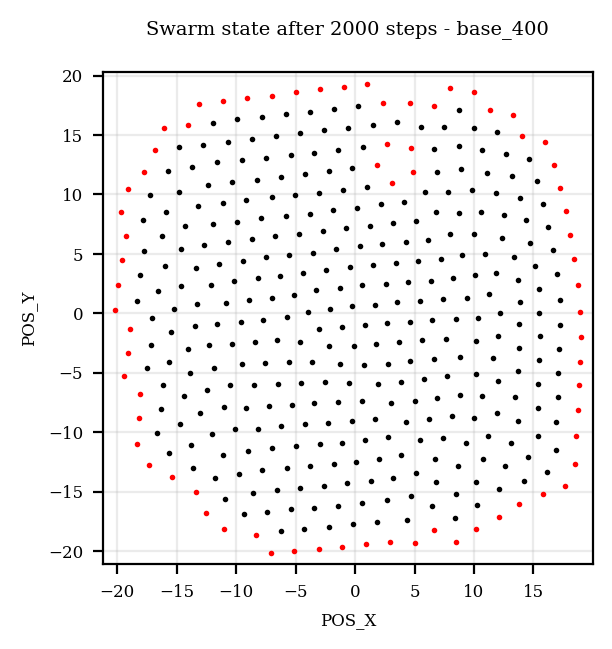

(PyPlot.Figure(PyObject <Figure size 700x700 with 1 Axes>), PyObject <Axes: title={'center': 'Swarm state after 2000 steps - base_400\n'}, xlabel='POS_X', ylabel='POS_Y'>)

In [5]:
n_steps = 2000
sim = "base_400"
config_file = "$(config)/$(sim).json"
b, parameters = load_swarm(config_file)
run_simulation_for_n_steps(b, parameters, n_steps)
show_swarm(config_file, system=(b, parameters), title="Swarm state after $(n_steps) steps", savedfigure="$(figs)/$(sim)_step_$(n_steps).pdf")

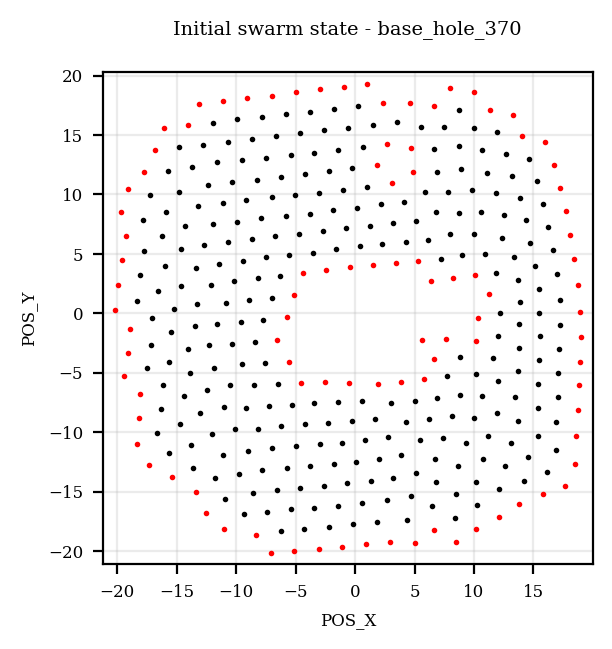

(PyPlot.Figure(PyObject <Figure size 700x700 with 1 Axes>), PyObject <Axes: title={'center': 'Initial swarm state - base_hole_370\n'}, xlabel='POS_X', ylabel='POS_Y'>)

In [6]:
show_swarm("$(config)/base_hole_370.json", title="Initial swarm state", savedfigure="$(figs)/base_hole_370_init.pdf")

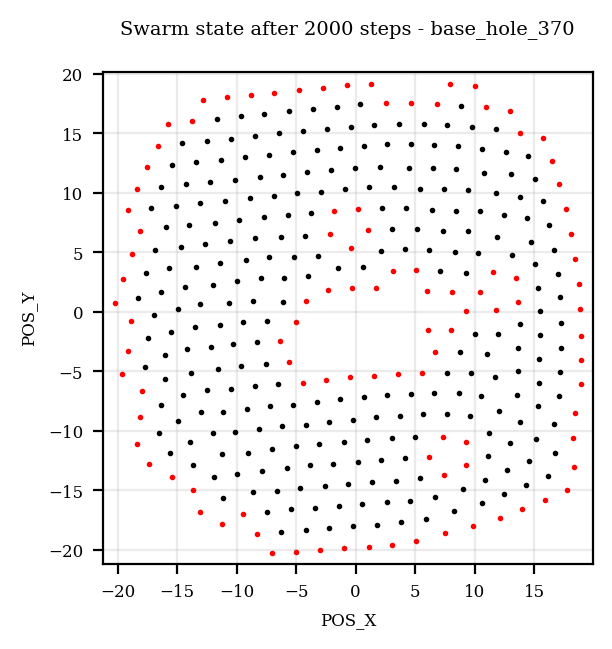

(PyPlot.Figure(PyObject <Figure size 700x700 with 1 Axes>), PyObject <Axes: title={'center': 'Swarm state after 2000 steps - base_hole_370\n'}, xlabel='POS_X', ylabel='POS_Y'>)

In [7]:
n_steps = 2000
sim = "base_hole_370"
config_file = "$(config)/$(sim).json"
b, parameters = load_swarm(config_file)
run_simulation_for_n_steps(b, parameters, n_steps)
show_swarm(config_file, system=(b, parameters), title="Swarm state after $(n_steps) steps", savedfigure="$(figs)/$(sim)_step_$(n_steps).pdf")

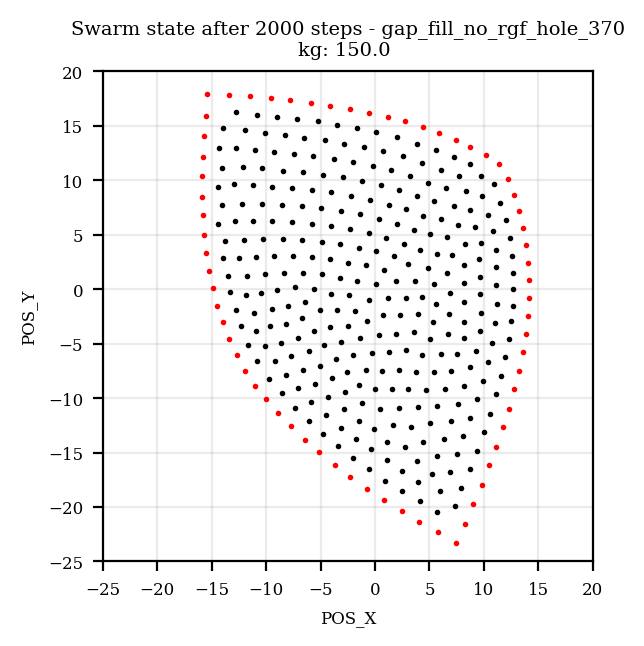

(PyPlot.Figure(PyObject <Figure size 700x700 with 1 Axes>), PyObject <Axes: title={'center': 'Swarm state after 2000 steps - gap_fill_no_rgf_hole_370\nkg: 150.0 '}, xlabel='POS_X', ylabel='POS_Y'>)

In [8]:
n_steps = 2000
sim = "gap_fill_no_rgf_hole_370"
config_file = "$(config)/$(sim).json"
b, parameters = load_swarm(config_file)
run_simulation_for_n_steps(b, parameters, n_steps)
show_swarm(config_file, system=(b, parameters), title="Swarm state after $(n_steps) steps", xlims=(-25, 20), ylims=(-25, 20), step=5, savedfigure="$(figs)/$(sim)_step_$(n_steps).pdf")

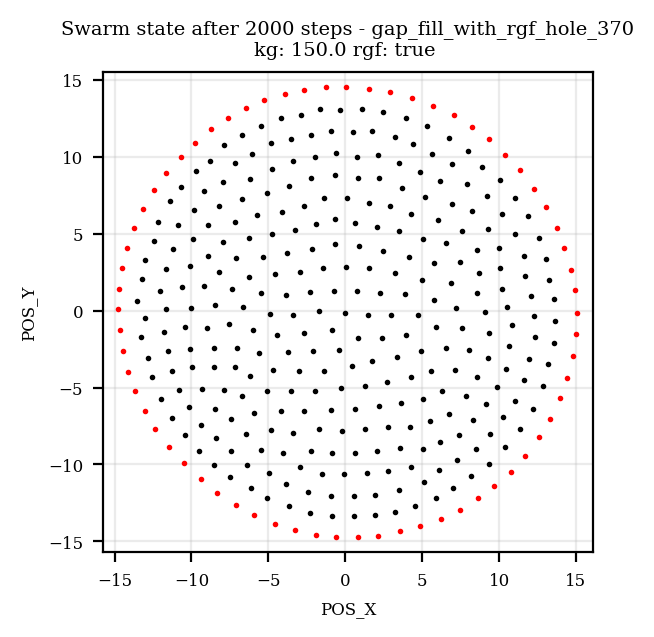

(PyPlot.Figure(PyObject <Figure size 700x700 with 1 Axes>), PyObject <Axes: title={'center': 'Swarm state after 2000 steps - gap_fill_with_rgf_hole_370\nkg: 150.0 rgf: true '}, xlabel='POS_X', ylabel='POS_Y'>)

In [9]:
n_steps = 2000
sim = "gap_fill_with_rgf_hole_370"
config_file = "$(config)/$(sim).json"
b, parameters = load_swarm(config_file)
run_simulation_for_n_steps(b, parameters, n_steps)
show_swarm(config_file, system=(b, parameters), title="Swarm state after $(n_steps) steps", savedfigure="$(figs)/$(sim)_step_$(n_steps).pdf")

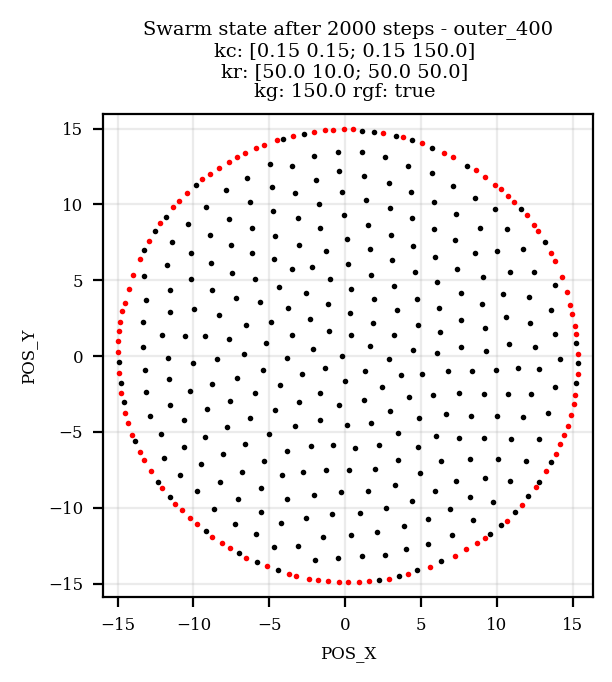

(PyPlot.Figure(PyObject <Figure size 700x700 with 1 Axes>), PyObject <Axes: title={'center': 'Swarm state after 2000 steps - outer_400\nkc: [0.15 0.15; 0.15 150.0] \nkr: [50.0 10.0; 50.0 50.0] \nkg: 150.0 rgf: true '}, xlabel='POS_X', ylabel='POS_Y'>)

In [10]:
n_steps = 2000
sim = "outer_400"
config_file = "$(config)/$(sim).json"
b, parameters = load_swarm(config_file)
run_simulation_for_n_steps(b, parameters, n_steps)
show_swarm(config_file, system=(b, parameters), title="Swarm state after $(n_steps) steps", savedfigure="$(figs)/$(sim)_step_$(n_steps).pdf")

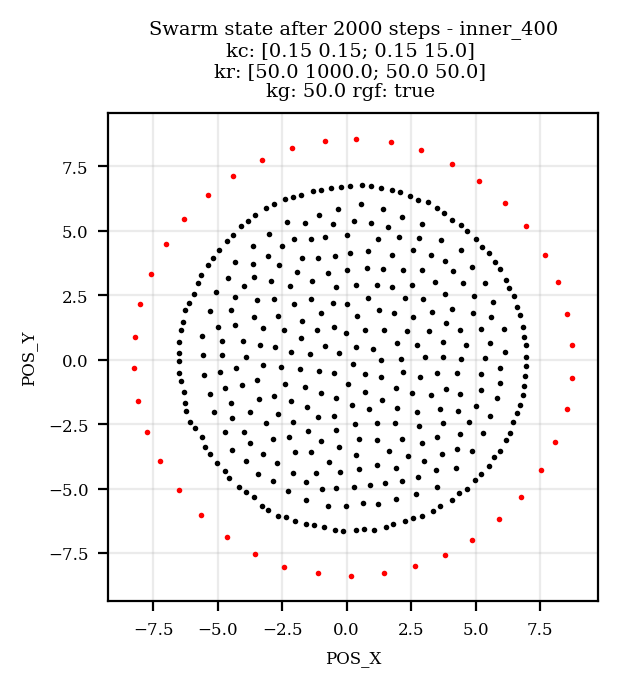

(PyPlot.Figure(PyObject <Figure size 700x700 with 1 Axes>), PyObject <Axes: title={'center': 'Swarm state after 2000 steps - inner_400\nkc: [0.15 0.15; 0.15 15.0] \nkr: [50.0 1000.0; 50.0 50.0] \nkg: 50.0 rgf: true '}, xlabel='POS_X', ylabel='POS_Y'>)

In [11]:
n_steps = 2000
sim = "inner_400"
config_file = "$(config)/$(sim).json"
b, parameters = load_swarm(config_file)
run_simulation_for_n_steps(b, parameters, n_steps)
show_swarm(config_file, system=(b, parameters), title="Swarm state after $(n_steps) steps", savedfigure="$(figs)/$(sim)_step_$(n_steps).pdf")

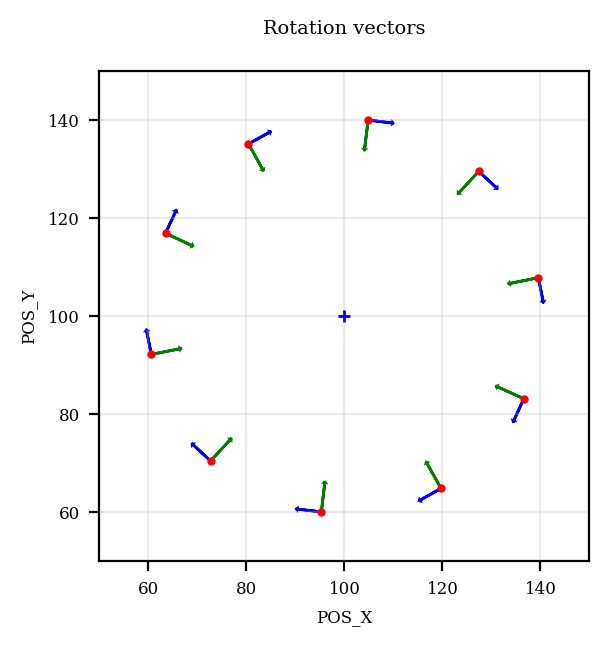

In [12]:
b = SM.mk_rand_swarm(10, grid=√10)
b[:,SM.GOAL_X:SM.GOAL_Y] .= [100.0 100.0]
parameters = deepcopy(SM.default_swarm_params)
parameters[:rb] = [96.0 96.0; 96.0 108.0]
parameters[:cb] = 144.0
parameters[:kr] = [150.0 50.0; 150.0 50.0]
parameters[:kd] = [0.15, 0.15]
parameters[:ka] = [0.0, 5]
parameters[:ra] = [0.0, π/2]
parameters[:kg] = 200.0
parameters[:rgf] = true
n_steps = 10000
run_simulation_for_n_steps(b, parameters, n_steps)
sim = "rotation_vector"
config_file = "$(sim).json"
fig, ax = show_swarm("", system=(b,parameters), title="Rotation vectors", goal=[100 100], xlims=(50, 150), ylims=(50,150), with_params=false, markersize=2)
for i in 1:10
    ax.arrow(b[i,SM.POS_X], b[i,SM.POS_Y], b[i,SM.DIR_X], b[i,SM.DIR_Y], width=0.0005, head_width=0.2, head_length=0.1, color="green")
    ax.arrow(b[i,SM.POS_X], b[i,SM.POS_Y], b[i,SM.ROT_X], b[i,SM.ROT_Y], width=0.0005, head_width=0.2, head_length=0.1, color="blue")
end
fig.savefig("$(figs)/$(sim).pdf", bbox_inches="tight")

In [13]:
MS.centroid(b), MS.radius(b), MS.area(b), size(b)[1] / MS.area(b)

((100.05919869789999, 100.073667279), 40.271104036792956, 5094.915020659471, 0.0019627412742804938)

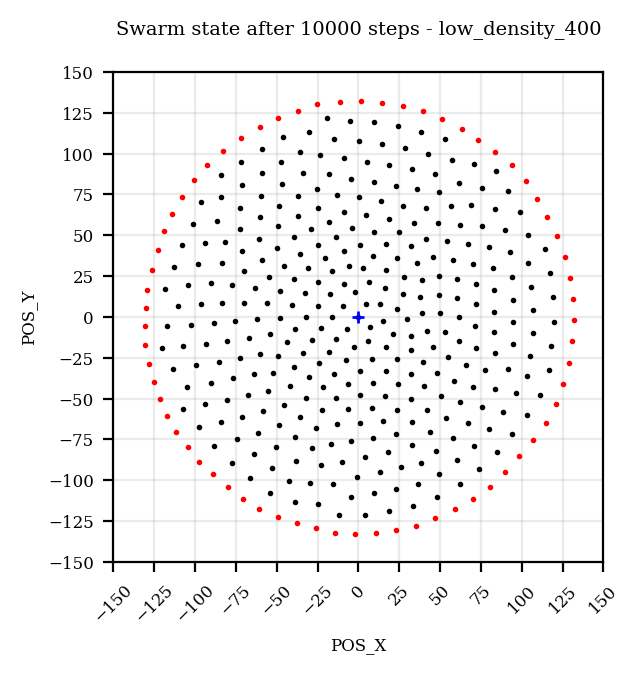

(PyPlot.Figure(PyObject <Figure size 700x700 with 1 Axes>), PyObject <Axes: title={'center': 'Swarm state after 10000 steps - low_density_400\n'}, xlabel='POS_X', ylabel='POS_Y'>)

In [14]:
n_steps = 10000
sim = "low_density_400"
config_file = "$(config)/$(sim).json"
b, parameters = load_swarm(config_file)
b[:,SM.GOAL_X:SM.GOAL_Y] .= [0.0 0.0]
run_simulation_for_n_steps(b, parameters, n_steps)
show_swarm(config_file, system=(b, parameters), goal=[0 0], title="Swarm state after $(n_steps) steps", xlims=(-150,150), ylims=(-150,150), step=25, 
           xmargin=5, ymargin=5, xtick_rotation=45, compute=false, with_params=false, savedfigure="$(figs)/$(sim)_step_$(n_steps).pdf")

In [15]:
MS.centroid(b), MS.radius(b), MS.area(b), size(b)[1] / MS.area(b)

((0.19076392158500027, -0.39393029221499937), 131.52328969241313, 54344.45011716168, 0.007360457215734753)

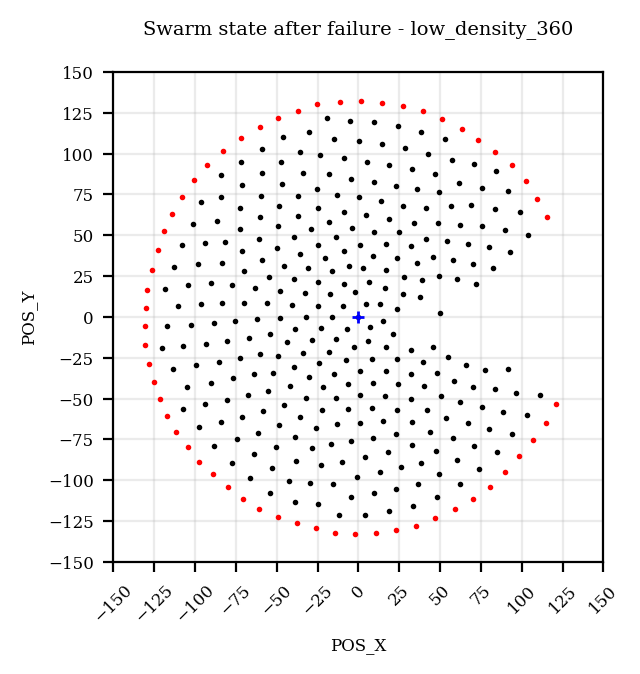

(PyPlot.Figure(PyObject <Figure size 700x700 with 1 Axes>), PyObject <Axes: title={'center': 'Swarm state after failure - low_density_360\n'}, xlabel='POS_X', ylabel='POS_Y'>)

In [16]:
sim = "low_density_360"
config_file = "$(config)/$(sim).json"
failed = sort([324, 340, 231, 281, 132, 205, 13, 390, 122, 241, 59, 153, 126, 343, 211, 379, 105, 167, 273, 275, 193, 79, 121, 227, 302, 252, 83, 253, 367, 84, 11, 293, 98, 111, 68, 348, 41, 169, 352, 113])
b_ = [b[a,:] for a in 1:size(b)[1] if a ∉ failed]
b = collect(transpose(reshape(collect(Iterators.flatten(b_)),(20,360))))
show_swarm(config_file, system=(b, parameters), goal=[0 0], title="Swarm state after failure", xlims=(-150,150), ylims=(-150,150), step=25, 
           xmargin=5, ymargin=5, xtick_rotation=45, compute=false, with_params=false, savedfigure="$(figs)/$(sim)_after_failure.pdf")

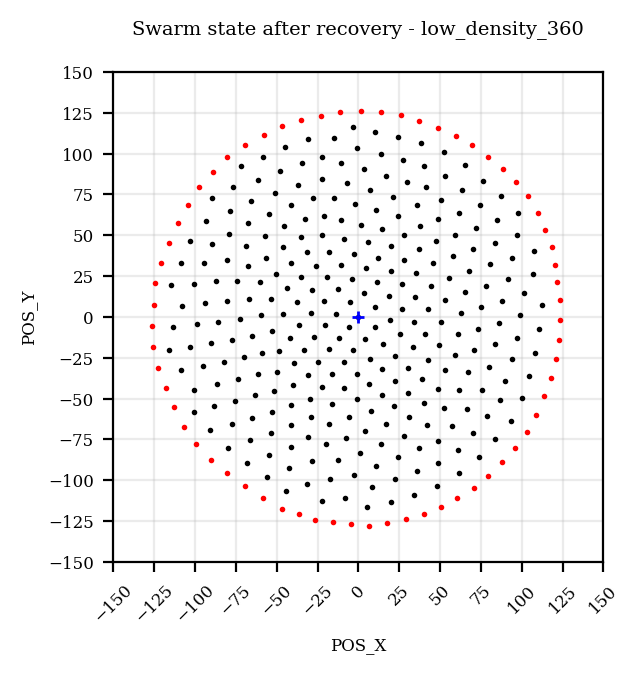

(PyPlot.Figure(PyObject <Figure size 700x700 with 1 Axes>), PyObject <Axes: title={'center': 'Swarm state after recovery - low_density_360\n'}, xlabel='POS_X', ylabel='POS_Y'>)

In [17]:
n_steps = 5000
sim = "low_density_360"
config_file = "$(config)/$(sim).json"
run_simulation_for_n_steps(b, parameters, n_steps)
show_swarm(config_file, system=(b, parameters), goal=[0 0], title="Swarm state after recovery", xlims=(-150,150), ylims=(-150,150), step=25, 
           xmargin=5, ymargin=5, xtick_rotation=45, compute=false, with_params=false, savedfigure="$(figs)/$(sim)_step_$(n_steps).pdf")

In [18]:
MS.centroid(b), MS.radius(b), MS.area(b), size(b)[1] / MS.area(b)

((-0.23344461090833285, -0.09371726929722261), 125.71396299402271, 49649.731841936424, 0.007250794448318201)

## Analysis

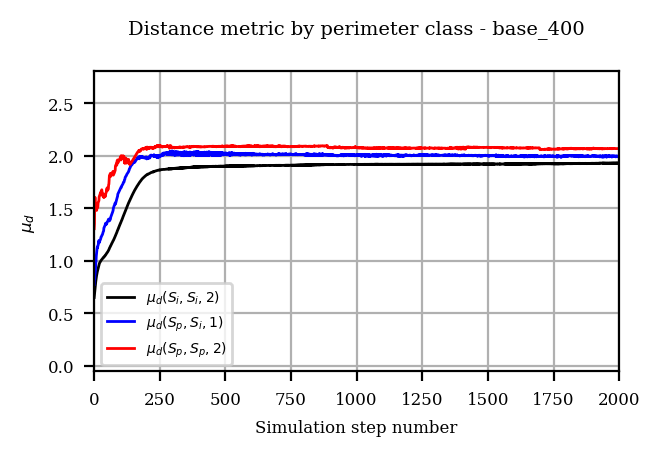

(PyPlot.Figure(PyObject <Figure size 700x500 with 1 Axes>), PyObject <Axes: title={'center': 'Distance metric by perimeter class - base_400\n '}, xlabel='Simulation step number', ylabel='$\\mu_d$'>, [0.6491975166742988 0.7731094073924227 1.3049238818828588; 0.6763925350317567 0.8201499966205622 1.3508663801050975; … ; 1.9304783023915013 1.997849294573608 2.068998908006963; 1.9284300144947382 1.9926986333530594 2.0684195901824016], [0.3423050458382315 0.5085709902111689 0.7049963603145877; 0.32674945302944275 0.496791538788886 0.680167579761362; … ; 0.06375750741958278 0.04891924015651427 0.12062366265210381; 0.06362430095279832 0.04473886283573076 0.1148551058957257])

In [19]:
n_steps = 2000
sim = "base_400"
config_file = "$(config)/$(sim).json"
plot_mean_distances(config_file, n_steps=n_steps, savedfigure="$(figs)/$(sim)_d_$(n_steps).pdf")

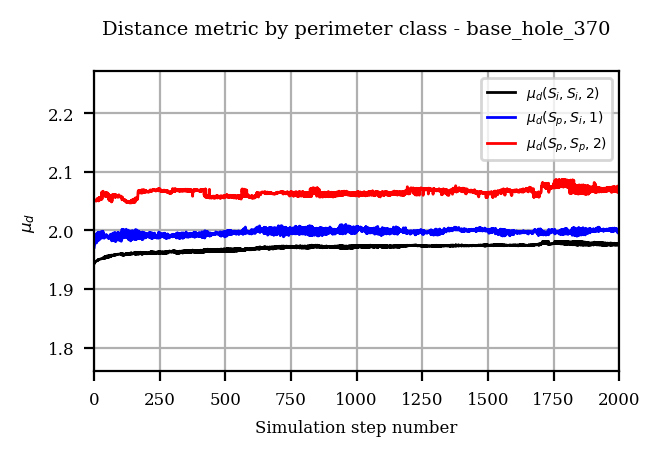

(PyPlot.Figure(PyObject <Figure size 700x500 with 1 Axes>), PyObject <Axes: title={'center': 'Distance metric by perimeter class - base_hole_370\n '}, xlabel='Simulation step number', ylabel='$\\mu_d$'>, [1.9450635751955574 1.9713211235437726 2.051407724638922; 1.9435809063970786 1.9754089326664837 2.05016098453322; … ; 1.97517886467972 2.0028352325107317 2.065690694627945; 1.9774000111564705 1.998345445689786 2.0753167959085874], [0.055958659574125956 0.06341717317119422 0.1269374992358105; 0.055785799626752335 0.051674279805675155 0.12425457296416142; … ; 0.03677345453230758 0.05704294205301047 0.12359835105516316; 0.053990878919707504 0.051901043631949105 0.1474032433238642])

In [20]:
n_steps = 2000
sim = "base_hole_370"
config_file = "$(config)/$(sim).json"
plot_mean_distances(config_file, n_steps=n_steps, savedfigure="$(figs)/$(sim)_d_$(n_steps).pdf")

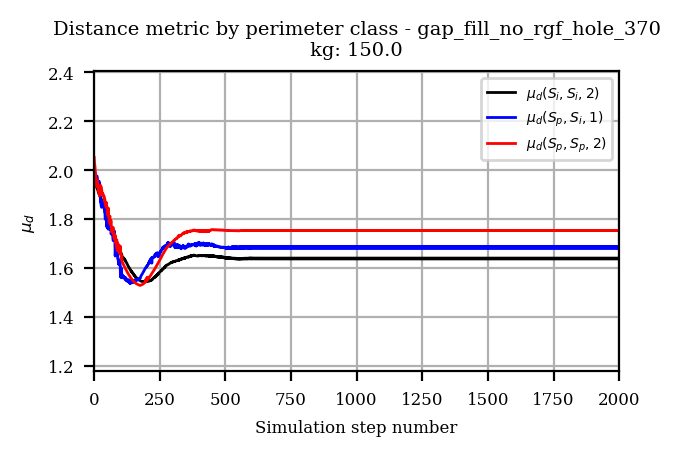

(PyPlot.Figure(PyObject <Figure size 700x500 with 1 Axes>), PyObject <Axes: title={'center': 'Distance metric by perimeter class - gap_fill_no_rgf_hole_370\n kg: 150.0 '}, xlabel='Simulation step number', ylabel='$\\mu_d$'>, [1.9450635751955574 1.9713211235437726 2.051407724638922; 1.9435809063970786 1.9670272715171955 2.0323189575890406; … ; 1.6371606337955167 1.687584746372319 1.7527735616917435; 1.6400531737848982 1.6813884013183302 1.753227661449605], [0.055958659574125956 0.06341717317119422 0.1269374992358105; 0.055785799626752335 0.05528271833775876 0.11687823957245043; … ; 0.10782800673510039 0.13211233603169628 0.14058814970696; 0.10471037116072578 0.13768586064598487 0.13908924817045693])

In [21]:
n_steps = 2000
sim = "gap_fill_no_rgf_hole_370"
config_file = "$(config)/$(sim).json"
plot_mean_distances(config_file, n_steps=n_steps, savedfigure="$(figs)/$(sim)_d_$(n_steps).pdf")

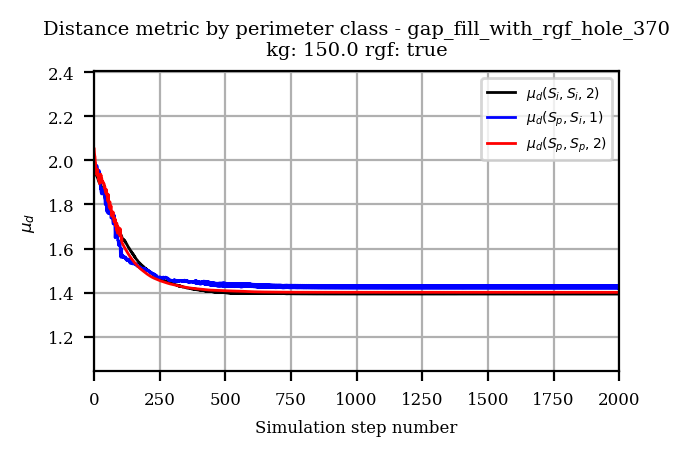

(PyPlot.Figure(PyObject <Figure size 700x500 with 1 Axes>), PyObject <Axes: title={'center': 'Distance metric by perimeter class - gap_fill_with_rgf_hole_370\n kg: 150.0 rgf: true '}, xlabel='Simulation step number', ylabel='$\\mu_d$'>, [1.9450635751955574 1.9713211235437726 2.051407724638922; 1.9435809063970786 1.9670272715171955 2.0323189575890406; … ; 1.3941911877529676 1.432350623558286 1.401325953428721; 1.3968000044693016 1.4208709544454763 1.401256448986931], [0.055958659574125956 0.06341717317119422 0.1269374992358105; 0.055785799626752335 0.05528271833775876 0.11687823957245043; … ; 0.08894144519425498 0.09620164599324015 0.06358519390529989; 0.08863555970326029 0.09626417417318707 0.06384623792334607])

In [22]:
n_steps = 2000
sim = "gap_fill_with_rgf_hole_370"
config_file = "$(config)/$(sim).json"
plot_mean_distances(config_file, n_steps=n_steps, savedfigure="$(figs)/$(sim)_d_$(n_steps).pdf")

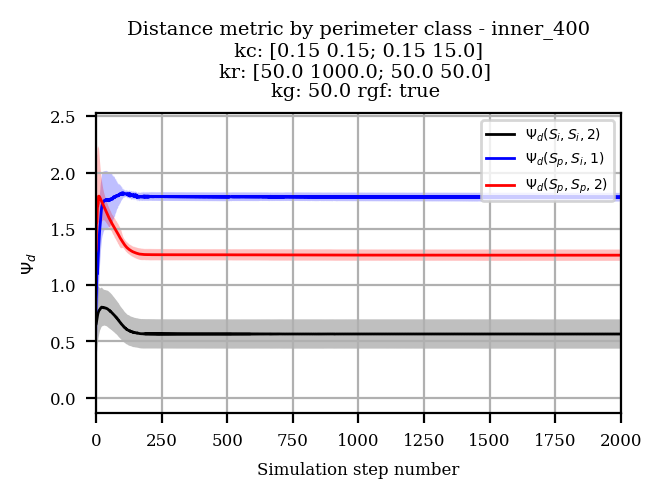

(PyPlot.Figure(PyObject <Figure size 700x500 with 1 Axes>), PyObject <Axes: title={'center': 'Distance metric by perimeter class - inner_400\n kc: [0.15 0.15; 0.15 15.0] \nkr: [50.0 1000.0; 50.0 50.0] \nkg: 50.0 rgf: true '}, xlabel='Simulation step number', ylabel='$\\Psi_d$'>, [0.6491975166742988 0.7731094073924227 1.3049238818828588; 0.6549203767400686 0.8820045843535153 1.318816712508274; … ; 0.566564268490905 1.7832962482353283 1.2664289891330636; 0.5661427407237538 1.7794645666857922 1.2664146869469433], [0.3423050458382315 0.5085709902111689 0.7049963603145877; 0.31922068337601517 0.5128767784472996 0.6798782264356027; … ; 0.1296510545953714 0.03926945010223931 0.05123180838115909; 0.13037979693548596 0.037950004324900304 0.04952622960221883])

In [23]:
n_steps = 2000
sim = "inner_400"
config_file = "$(config)/$(sim).json"
plot_mean_distances(config_file, n_steps=n_steps, with_stdev=true, legend_loc="upper right", savedfigure="$(figs)/$(sim)_ds_$(n_steps).pdf")

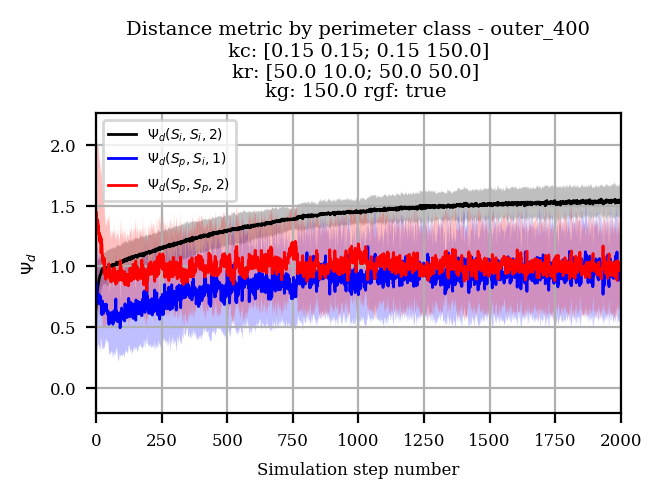

(PyPlot.Figure(PyObject <Figure size 700x500 with 1 Axes>), PyObject <Axes: title={'center': 'Distance metric by perimeter class - outer_400\n kc: [0.15 0.15; 0.15 150.0] \nkr: [50.0 10.0; 50.0 50.0] \nkg: 150.0 rgf: true '}, xlabel='Simulation step number', ylabel='$\\Psi_d$'>, [0.6491975166742988 0.7731094073924227 1.3049238818828588; 0.6756282989312923 0.810799619339713 1.2899398347337199; … ; 1.524670515407066 0.8920621275714153 1.0337858801146922; 1.537730988114873 0.9566826753632809 0.9987404783497722], [0.3423050458382315 0.5085709902111689 0.7049963603145877; 0.31854427980835553 0.5140762917636589 0.6698000099092758; … ; 0.14306383912971954 0.3347701310633669 0.39287639285203274; 0.13635689114654537 0.3984785103115432 0.3673917101858204])

In [24]:
n_steps = 2000
sim = "outer_400"
config_file = "$(config)/$(sim).json"
plot_mean_distances(config_file, n_steps=n_steps, with_stdev=true, savedfigure="$(figs)/$(sim)_ds_$(n_steps).pdf")

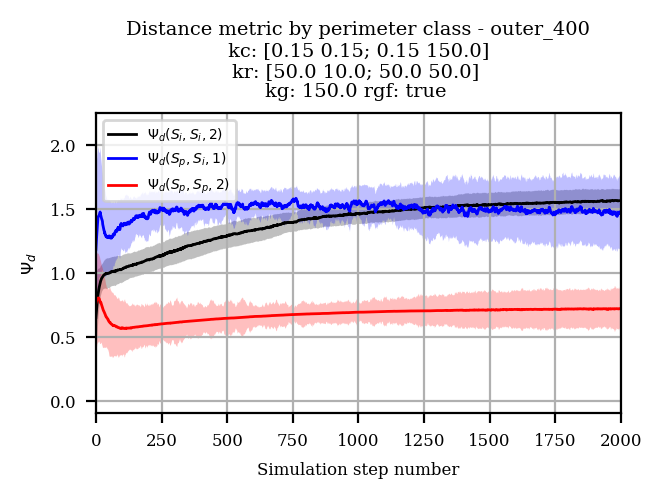

(PyPlot.Figure(PyObject <Figure size 700x500 with 1 Axes>), PyObject <Axes: title={'center': 'Distance metric by perimeter class - outer_400\n kc: [0.15 0.15; 0.15 150.0] \nkr: [50.0 10.0; 50.0 50.0] \nkg: 150.0 rgf: true '}, xlabel='Simulation step number', ylabel='$\\Psi_d$'>, [0.6509993729384532 1.183516288177746 0.7613727709790107; 0.6766527957170743 1.2271525991881218 0.7706463487980336; … ; 1.5640563364398647 1.4648222837303544 0.7206358111234601; 1.563899207026704 1.4696279642772367 0.7207415531177218], [0.34089275198531754 0.6625872780152369 0.39276509516194313; 0.3231967278818863 0.6546990166033942 0.3846039774681154; … ; 0.09207757316626583 0.28335094488815704 0.15804691929069334; 0.08961326196056305 0.28496307057111203 0.16222050664492718])

In [25]:
n_steps = 2000
sim = "outer_400"
config_file = "$(config)/$(sim).json"
plot_mean_distances(config_file, n_steps=n_steps, with_stdev=true, pre_p=true, savedfigure="$(figs)/$(sim)_ds_pre_p_$(n_steps).pdf")

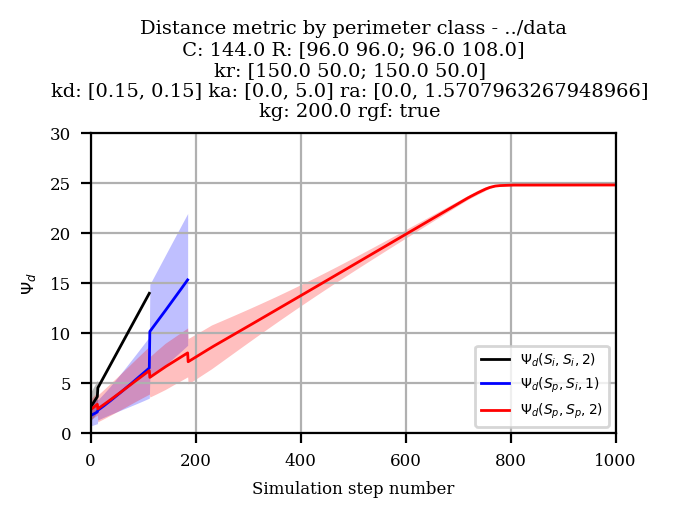

(PyPlot.Figure(PyObject <Figure size 700x500 with 1 Axes>), PyObject <Axes: title={'center': 'Distance metric by perimeter class - ../data\n C: 144.0 R: [96.0 96.0; 96.0 108.0] \nkr: [150.0 50.0; 150.0 50.0] \nkd: [0.15, 0.15] ka: [0.0, 5.0] ra: [0.0, 1.5707963267948966] \nkg: 200.0 rgf: true '}, xlabel='Simulation step number', ylabel='$\\Psi_d$'>, [2.612144154258582 1.77796022427868 2.3511835451268204; 2.6931344177528938 1.8052434242901083 2.3956501091798637; … ; NaN NaN 24.846553265191808; NaN NaN 24.84633633303364], [1.4199524843238236 1.085565037340341 1.0283730998480272; 1.434157410007493 1.0946263396410862 1.03781992150826; … ; NaN NaN 0.11796641449612609; NaN NaN 0.11869244039177687])

In [26]:
b = SM.mk_rand_swarm(10, grid=√10)
b[:,SM.GOAL_X:SM.GOAL_Y] .= [100.0 100.0]
parameters = deepcopy(SM.default_swarm_params)
parameters[:rb] = [96.0 96.0; 96.0 108.0]
parameters[:cb] = 144.0
parameters[:kr] = [150.0 50.0; 150.0 50.0]
parameters[:kd] = [0.15, 0.15 ]
parameters[:ka] = [0.0, 5.0]
parameters[:ra] = [0.0, π/2]
parameters[:kg] = 200.0
parameters[:rgf] = true
system = (b, parameters)
n_steps = 1000
sim = "border_patrol_10"
plot_mean_distances(system=system, goal=[100.0 100.0], n_steps=n_steps, with_stdev=true, ylims=(0,30), alt_file=config, 
                    legend_loc="lower right", savedfigure="$(figs)/$(sim)_ds_$(n_steps).pdf")

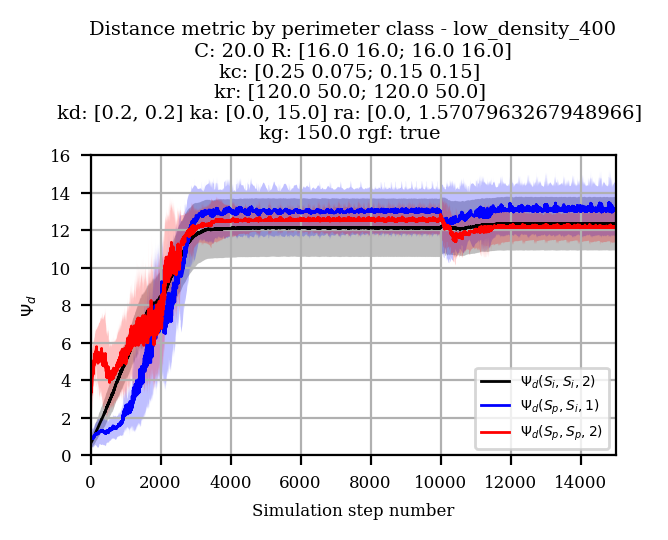

(PyPlot.Figure(PyObject <Figure size 700x500 with 1 Axes>), PyObject <Axes: title={'center': 'Distance metric by perimeter class - low_density_400\n C: 20.0 R: [16.0 16.0; 16.0 16.0] \nkc: [0.25 0.075; 0.15 0.15] \nkr: [120.0 50.0; 120.0 50.0] \nkd: [0.2, 0.2] ka: [0.0, 15.0] ra: [0.0, 1.5707963267948966] \nkg: 150.0 rgf: true '}, xlabel='Simulation step number', ylabel='$\\Psi_d$'>, [0.6300729627952661 0.9299050775545834 3.5759297929376492; 0.6332883012967339 0.9242275611873739 3.6152106529204358; … ; 12.359210133783945 13.070651024509267 12.158014061924556; 12.361030506897196 13.071202433432807 12.157956929476523], [0.3190689677022941 0.6819633195024524 2.890606097577585; 0.3201369434964195 0.6831209296020979 2.867168305780924; … ; 1.4212237986881777 1.4268445613601883 0.794579740120897; 1.4193983678466822 1.421823127516723 0.7946185294379507])

In [27]:
n_steps = 15000
sim = "low_density_400"
config_file = "$(config)/$(sim).json"
plot_mean_distances(config_file, goal=[0.0 0.0], n_steps=15000, failure=(10000, failed), with_stdev=true, ylims=(0,16), savedfigure="$(figs)/$(sim)_ds_$(n_steps).pdf")

## Animations

In [28]:
using Plots; gr()

Plots.GRBackend()

┌ Info: Saved animation to /home/dk0/doodle/julia/swarm_simulator/ESWA_120183/code/tmp.gif
└ @ Plots /home/dk0/.julia/packages/Plots/tDHxD/src/animation.jl:156


Plots.AnimatedGif("/home/dk0/doodle/julia/swarm_simulator/ESWA_120183/code/tmp.gif")
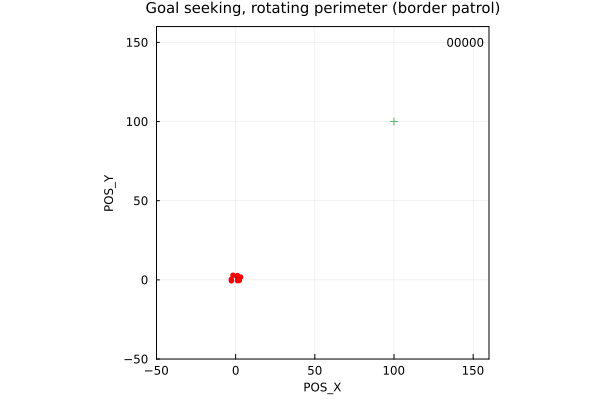

In [29]:
n_steps = 10000
b = SM.mk_rand_swarm(10, grid=√10)
b[:,SM.GOAL_X:SM.GOAL_Y] .= [100.0 100.0]
parameters = deepcopy(SM.default_swarm_params)
parameters[:rb] = [96.0 96.0; 96.0 108.0]
parameters[:cb] = 144.0
parameters[:kr] = [150.0 50.0; 150.0 50.0]
parameters[:kd] = [0.15, 0.15]
parameters[:ka] = [0.0, 5]
parameters[:ra] = [0.0, π/2]
parameters[:kg] = 200.0
parameters[:rgf] = true

@gif for i in 1:n_steps + 1
    global b
    compute_step(b; parameters...)
    prm = findall(b[:,SM.PRM] .> 0.)
    _prm = setdiff(1:size(b)[1], prm)
    scatter(b[_prm,SM.POS_X],b[_prm,SM.POS_Y]; titlefontsize=10, labelfontsize=8, title="Goal seeking, rotating perimeter (border patrol)", legend=false, 
            markersize=3, markercolor=:black, aspect_ratio=:equal, framestyle=:box, annotationfontsize=8, annotations=(145,150, lpad(i-1, 5, "0")),
            xlabel="POS_X", ylabel="POS_Y", xlims=[-50,160], ylims=[-50,160])
    scatter!(b[prm,SM.POS_X],b[prm,SM.POS_Y]; legend=false, markersize=3, markercolor=:red, markerstrokecolor=:red, aspect_ratio=:equal)
    plot!([b[:,SM.GOAL_X][1]], [b[:,SM.GOAL_Y][1]], markershape=:cross, markersize=4)
    apply_step(b)
end every 5

In [30]:
convert_cmd = `ffmpeg -i ./tmp.gif -c:v libx264 -preset slow -crf 20 -b:v 750k -pix_fmt yuv420p -vf "scale=trunc(iw/2)*2:trunc(ih/2)*2" -movflags +faststart ../results/border_patrol.mp4`
run(convert_cmd)

ffmpeg version n6.0 Copyright (c) 2000-2023 the FFmpeg developers
  built with gcc 12.2.1 (GCC) 20230201
  configuration: --prefix=/usr --disable-debug --disable-static --disable-stripping --enable-amf --enable-avisynth --enable-cuda-llvm --enable-lto --enable-fontconfig --enable-gmp --enable-gnutls --enable-gpl --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libdav1d --enable-libdrm --enable-libfreetype --enable-libfribidi --enable-libgsm --enable-libiec61883 --enable-libjack --enable-libjxl --enable-libmfx --enable-libmodplug --enable-libmp3lame --enable-libopencore_amrnb --enable-libopencore_amrwb --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librav1e --enable-librsvg --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libsvtav1 --enable-libtheora --enable-libv4l2 --enable-libvidstab --enable-libvmaf --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx264 --enable

Process(`ffmpeg -i ./tmp.gif -c:v libx264 -preset slow -crf 20 -b:v 750k -pix_fmt yuv420p -vf 'scale=trunc(iw/2)*2:trunc(ih/2)*2' -movflags +faststart ../results/border_patrol.mp4`, ProcessExited(0))

┌ Info: Saved animation to /home/dk0/doodle/julia/swarm_simulator/ESWA_120183/code/tmp.gif
└ @ Plots /home/dk0/.julia/packages/Plots/tDHxD/src/animation.jl:156


Plots.AnimatedGif("/home/dk0/doodle/julia/swarm_simulator/ESWA_120183/code/tmp.gif")
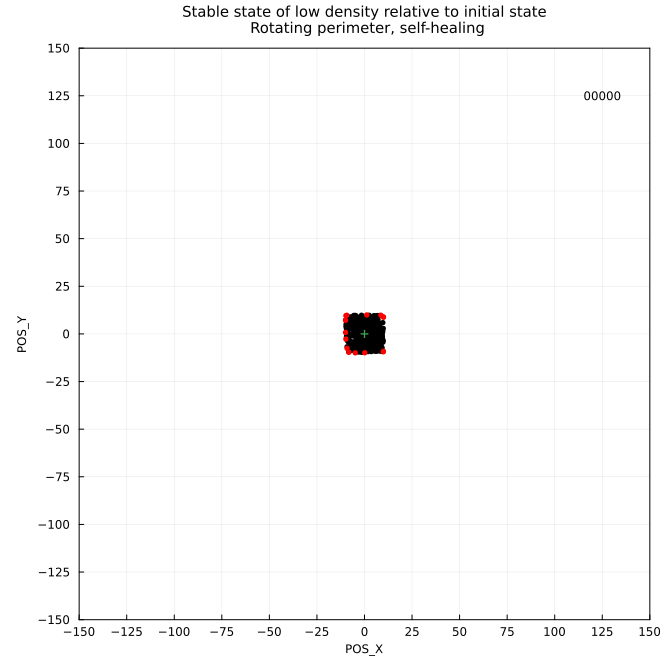

In [31]:
n_steps = 15000
sim = "low_density_400"
config_file = "$(config)/$(sim).json"
b, parameters = load_swarm(config_file)
b[:,SM.GOAL_X:SM.GOAL_Y] .= [0.0 0.0]

@gif for i in 1:n_steps + 1
    global b
    compute_step(b; parameters...)
    prm = findall(b[:,SM.PRM] .> 0.)
    _prm = setdiff(1:size(b)[1], prm)
    scatter(b[_prm,SM.POS_X],b[_prm,SM.POS_Y]; title="Stable state of low density relative to initial state\n Rotating perimeter, self-healing", titlefontsize=10, labelfontsize=8, legend=false, markersize=3, markercolor=:black, aspect_ratio=:equal, size=(672, 672), xlabel="POS_X", ylabel="POS_Y", xlims=[-150,150], ylims=[-150,150], xticks=[n for n in -150:25:150], yticks=[n for n in -150:25:150])
    scatter!(b[prm,SM.POS_X],b[prm,SM.POS_Y]; legend=false, markersize=3, markercolor=:red, markerstrokecolor=:red, aspect_ratio=:equal, framestyle=:box, annotationfontsize=8, annotations=(125, 125, lpad(i-1, 5, "0")))
    plot!([b[:,SM.GOAL_X][1]], [b[:,SM.GOAL_Y][1]], markershape=:cross, markersize=4)
    apply_step(b)
    if i == 10000
        failed = sort([324, 340, 231, 281, 132, 205, 13, 390, 122, 241, 59, 153, 126, 343, 211, 379, 105, 167, 273, 275, 193, 79, 121, 227, 302, 252, 83, 253, 367, 84, 11, 293, 98, 111, 68, 348, 41, 169, 352, 113])
        b_ = [b[a,:] for a in 1:size(b)[1] if a ∉ failed]
        b = collect(transpose(reshape(collect(Iterators.flatten(b_)),(SM.N_COLS, size(b)[1] - length(failed)))))
    end
end every 10

In [32]:
convert_cmd = `ffmpeg -i ./tmp.gif -c:v libx264 -preset slow -crf 20 -b:v 750k -pix_fmt yuv420p -vf "scale=trunc(iw/2)*2:trunc(ih/2)*2" -movflags +faststart ../results/low_density.mp4`
run(convert_cmd)
cleanup_cmd = `rm ./tmp.gif`
run(cleanup_cmd)

ffmpeg version n6.0 Copyright (c) 2000-2023 the FFmpeg developers
  built with gcc 12.2.1 (GCC) 20230201
  configuration: --prefix=/usr --disable-debug --disable-static --disable-stripping --enable-amf --enable-avisynth --enable-cuda-llvm --enable-lto --enable-fontconfig --enable-gmp --enable-gnutls --enable-gpl --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libdav1d --enable-libdrm --enable-libfreetype --enable-libfribidi --enable-libgsm --enable-libiec61883 --enable-libjack --enable-libjxl --enable-libmfx --enable-libmodplug --enable-libmp3lame --enable-libopencore_amrnb --enable-libopencore_amrwb --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librav1e --enable-librsvg --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libsvtav1 --enable-libtheora --enable-libv4l2 --enable-libvidstab --enable-libvmaf --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx264 --enable

Process(`rm ./tmp.gif`, ProcessExited(0))